# Smart Water Analytics

Este proyecto dará solución al problema propuesto por la competición homonima en Kaggle.  
El principal objetivo de la competición es encontrar un modelo que prediga o determine que features son relevantes para la disponibilidad de agua, en cada tipo de cuerpo de agua. Los tipos de cuerpos de agua son. 
- acuíferos 
- ríos
- lagos. 
- manantiales

El outcome deseado es tener cuatro modelos predictores, uno por cada tipo de cuerpo de agua (acuíferos, cascadas, ríos y lagos).

# 1. Preparación del Entorno. 

Antes de cargar los datos, se importarán las librerías que se requerirán:

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np


# 2. Carga de Datos y EDA inicial. 

## Carga de Datos. 

### Acuíferos. 

In [2]:
# Aquifer Auser
df_aa = pd.read_csv("../data/raw/Aquifer_Auser.csv")
df_aa.head()


,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Temperature_Monte_Serra,Temperature_Ponte_a_Moriano,Temperature_Lucca_Orto_Botanico,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione
0,05/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,06/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,10.05,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,07/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,9.2,0.0,10.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,08/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.4,0.0,13.85,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,09/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.4,0.0,12.85,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
df_aa.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8154 entries, 0 to 8153
Data columns (total 27 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Date                                     8154 non-null   object 
 1   Rainfall_Gallicano                       5295 non-null   float64
 2   Rainfall_Pontetetto                      5295 non-null   float64
 3   Rainfall_Monte_Serra                     5289 non-null   float64
 4   Rainfall_Orentano                        5295 non-null   float64
 5   Rainfall_Borgo_a_Mozzano                 5295 non-null   float64
 6   Rainfall_Piaggione                       4930 non-null   float64
 7   Rainfall_Calavorno                       5295 non-null   float64
 8   Rainfall_Croce_Arcana                    5295 non-null   float64
 9   Rainfall_Tereglio_Coreglia_Antelminelli  5295 non-null   float64
 10  Rainfall_Fabbriche_di_Vallico            5295 no

In [4]:
df_aa.describe()

,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,...,Temperature_Monte_Serra,Temperature_Ponte_a_Moriano,Temperature_Lucca_Orto_Botanico,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione
count,5295.000000,5295.000000,5289.000000,5295.000000,5295.000000,4930.000000,5295.000000,5295.000000,5295.000000,5295.000000,...,8154.000000,8154.000000,8154.000000,5660.000000,5660.000000,5660.000000,5660.000000,5660.000000,7241.000000,6119.000000
mean,4.948782,3.495449,3.919077,3.150670,4.578961,3.953976,4.578886,2.849745,4.182927,5.922304,...,11.202079,10.971358,15.501134,-9316.138433,-16301.825866,-11808.085531,-2352.562424,-1985.775034,0.313618,-0.209204
std,14.366480,9.983772,10.815270,8.747507,12.771166,10.888103,12.461918,9.239679,11.135511,16.281733,...,6.903190,8.708626,7.138789,2224.435459,1490.096594,1444.085240,2854.176875,2534.301154,0.213851,0.849013
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-7.850000,-2.850000,-3.300000,-13883.225810,-18601.920000,-14438.304000,-7757.258065,-9497.774194,0.000000,-1.190000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,5.650000,0.000000,9.750000,-11004.654450,-17081.280000,-12769.920000,-5493.709677,-4354.392857,0.160000,-1.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,11.000000,10.875000,15.400000,-9728.571429,-16450.560000,-12078.720000,0.000000,0.000000,0.260000,-0.280000
75%,2.000000,1.000000,1.600000,1.000000,2.000000,1.400000,2.000000,1.400000,2.000000,3.000000,...,16.700000,18.550000,21.600000,-7323.783871,-15785.280000,-11015.136000,0.000000,0.000000,0.400000,0.580000
max,318.800000,146.600000,152.200000,108.800000,176.600000,140.800000,209.000000,285.000000,147.200000,197.000000,...,29.500000,30.750000,31.050000,-4114.670400,-7149.791935,-5569.298387,0.000000,0.000000,2.170000,3.690000


In [5]:
# Aquifer Doganella
df_ad = pd.read_csv("../data/raw/Aquifer_Doganella.csv")
df_ad.head()

,Date,Rainfall_Monteporzio,Rainfall_Velletri,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_2,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Depth_to_Groundwater_Pozzo_5,Depth_to_Groundwater_Pozzo_6,Depth_to_Groundwater_Pozzo_7,...,Volume_Pozzo_1,Volume_Pozzo_2,Volume_Pozzo_3,Volume_Pozzo_4,Volume_Pozzo_5+6,Volume_Pozzo_7,Volume_Pozzo_8,Volume_Pozzo_9,Temperature_Monteporzio,Temperature_Velletri
0,01/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.30,8.60
1,02/01/2004,0.2,0.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.70,6.25
2,03/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.40,9.80
3,04/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.35,5.95
4,05/01/2004,0.2,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.60,5.85


In [6]:
df_ad.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6026 entries, 0 to 6025
Data columns (total 22 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Date                          6026 non-null   object 
 1   Rainfall_Monteporzio          5399 non-null   float64
 2   Rainfall_Velletri             5374 non-null   float64
 3   Depth_to_Groundwater_Pozzo_1  2537 non-null   float64
 4   Depth_to_Groundwater_Pozzo_2  2736 non-null   float64
 5   Depth_to_Groundwater_Pozzo_3  2774 non-null   float64
 6   Depth_to_Groundwater_Pozzo_4  2374 non-null   float64
 7   Depth_to_Groundwater_Pozzo_5  2508 non-null   float64
 8   Depth_to_Groundwater_Pozzo_6  2428 non-null   float64
 9   Depth_to_Groundwater_Pozzo_7  2311 non-null   float64
 10  Depth_to_Groundwater_Pozzo_8  2551 non-null   float64
 11  Depth_to_Groundwater_Pozzo_9  2339 non-null   float64
 12  Volume_Pozzo_1                1356 non-null   float64
 13  Vol

In [7]:
df_ad.describe()

,Rainfall_Monteporzio,Rainfall_Velletri,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_2,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Depth_to_Groundwater_Pozzo_5,Depth_to_Groundwater_Pozzo_6,Depth_to_Groundwater_Pozzo_7,Depth_to_Groundwater_Pozzo_8,...,Volume_Pozzo_1,Volume_Pozzo_2,Volume_Pozzo_3,Volume_Pozzo_4,Volume_Pozzo_5+6,Volume_Pozzo_7,Volume_Pozzo_8,Volume_Pozzo_9,Temperature_Monteporzio,Temperature_Velletri
count,5399.000000,5374.000000,2537.000000,2736.000000,2774.000000,2374.000000,2508.000000,2428.000000,2311.000000,2551.000000,...,1356.000000,1360.000000,1360.000000,1360.000000,1360.000000,1360.000000,1360.000000,1360.000000,4564.000000,4383.000000
mean,2.893758,3.159732,-36.929137,-94.746188,-111.638928,-98.223934,-102.552596,-91.672955,-95.819225,-95.845370,...,1529.376211,3433.485746,3208.114931,3527.627374,7178.560713,2491.400685,3660.482101,3239.807765,13.458457,15.574038
std,8.624455,8.913341,10.179111,3.891286,3.809581,2.391763,3.711563,2.216446,1.686417,2.523905,...,1154.952073,772.564645,1084.939228,700.013152,1607.944298,671.378069,813.007457,730.314145,6.763101,6.352674
min,0.000000,0.000000,-59.500000,-112.500000,-117.800000,-108.660000,-109.890000,-99.480000,-97.430000,-107.500000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-3.620000,-0.270000
25%,0.000000,0.000000,-45.250000,-98.460000,-115.077500,-100.500000,-104.450000,-92.947500,-97.350000,-97.840000,...,484.695000,3521.215000,2730.862500,3596.372500,7272.557500,2282.235000,3795.562500,3110.930000,8.085000,10.365000
50%,0.000000,0.000000,-34.900000,-93.280000,-111.805000,-97.970000,-101.815000,-91.500000,-96.570000,-95.320000,...,1408.860000,3591.810000,3215.880000,3667.210000,7854.750000,2677.160000,3894.375000,3378.455000,13.050000,15.150000
75%,0.600000,0.600000,-28.510000,-91.290000,-108.030000,-96.050000,-99.867500,-90.027500,-94.020000,-93.595000,...,2546.995000,3845.600000,3734.505000,3864.400000,7999.130000,2917.105000,3988.800000,3466.797500,18.992500,20.725000
max,112.600000,106.600000,-20.310000,-89.670000,-100.590000,-94.000000,-96.220000,-88.600000,-91.640000,-92.470000,...,4171.280000,4030.270000,5378.800000,4076.100000,8360.210000,3427.420000,4341.710000,4336.780000,30.400000,31.900000


In [8]:
# Aquifer Luco
df_al = pd.read_csv("../data/raw/Aquifer_Luco.csv")
df_al.head()

,Date,Rainfall_Simignano,Rainfall_Siena_Poggio_al_Vento,Rainfall_Mensano,Rainfall_Montalcinello,Rainfall_Monticiano_la_Pineta,Rainfall_Sovicille,Rainfall_Ponte_Orgia,Rainfall_Scorgiano,Rainfall_Pentolina,...,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Temperature_Siena_Poggio_al_Vento,Temperature_Mensano,Temperature_Pentolina,Temperature_Monteroni_Arbia_Biena,Volume_Pozzo_1,Volume_Pozzo_3,Volume_Pozzo_4
0,01/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,5.50,0.80,NaN,NaN,NaN
1,02/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,6.20,3.25,NaN,NaN,NaN
2,03/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.25,0.95,NaN,NaN,NaN
3,04/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.00,4.20,NaN,NaN,NaN
4,05/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.90,6.55,NaN,NaN,NaN


In [9]:
df_al.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7487 entries, 0 to 7486
Data columns (total 22 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Date                                 7487 non-null   object 
 1   Rainfall_Simignano                   6822 non-null   float64
 2   Rainfall_Siena_Poggio_al_Vento       951 non-null    float64
 3   Rainfall_Mensano                     1722 non-null   float64
 4   Rainfall_Montalcinello               6525 non-null   float64
 5   Rainfall_Monticiano_la_Pineta        2205 non-null   float64
 6   Rainfall_Sovicille                   6657 non-null   float64
 7   Rainfall_Ponte_Orgia                 1260 non-null   float64
 8   Rainfall_Scorgiano                   3036 non-null   float64
 9   Rainfall_Pentolina                   2116 non-null   float64
 10  Rainfall_Monteroni_Arbia_Biena       3104 non-null   float64
 11  Depth_to_Groundwater_Podere_Ca

In [10]:
df_al.describe()

,Rainfall_Simignano,Rainfall_Siena_Poggio_al_Vento,Rainfall_Mensano,Rainfall_Montalcinello,Rainfall_Monticiano_la_Pineta,Rainfall_Sovicille,Rainfall_Ponte_Orgia,Rainfall_Scorgiano,Rainfall_Pentolina,Rainfall_Monteroni_Arbia_Biena,...,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Temperature_Siena_Poggio_al_Vento,Temperature_Mensano,Temperature_Pentolina,Temperature_Monteroni_Arbia_Biena,Volume_Pozzo_1,Volume_Pozzo_3,Volume_Pozzo_4
count,6822.00000,951.000000,1722.000000,6525.000000,2205.000000,6657.000000,1260.000000,3036.000000,2116.000000,3104.000000,...,1012.000000,920.000000,969.000000,7487.000000,7487.000000,7487.000000,7487.000000,2008.000000,2008.000000,2008.000000
mean,2.52146,2.269821,2.560743,2.477579,3.105850,2.281959,2.366825,3.222134,8.734783,2.391108,...,-11.100692,-9.892256,-13.098520,1.903954,3.343248,13.419761,13.593736,-160.684377,-147.773134,-135.214663
std,7.09014,6.039464,10.279711,7.488022,9.496626,7.053183,6.813364,21.307151,52.149236,7.602140,...,0.836808,0.667793,2.571084,5.602519,6.923075,7.249467,7.199626,51.220771,55.643788,56.818120
min,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-12.600000,-11.900000,-19.000000,-3.550000,-5.250000,-4.800000,-3.900000,-295.375015,-261.849600,-237.336612
25%,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-11.600000,-10.300000,-13.000000,0.000000,0.000000,7.950000,7.950000,-198.758660,-189.343442,-175.177124
50%,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-11.200000,-9.800000,-12.700000,0.000000,0.000000,13.200000,13.700000,-163.545061,-148.874123,-145.845891
75%,0.60000,1.200000,0.600000,0.600000,0.800000,0.400000,0.600000,0.800000,1.200000,0.600000,...,-10.600000,-9.400000,-11.400000,0.000000,0.000000,19.350000,19.650000,-119.615001,-110.467100,-96.849815
max,87.80000,79.200000,313.000000,134.600000,171.000000,194.200000,90.000000,794.200000,620.800000,137.600000,...,-2.800000,-8.200000,0.000000,31.800000,31.850000,31.300000,29.450000,-55.433467,0.000000,-0.053438


In [11]:
# Aquifer Petrignano
df_ap = pd.read_csv("../data/raw/Aquifer_Petrignano.csv")
df_ap.head()

,Date,Rainfall_Bastia_Umbra,Depth_to_Groundwater_P24,Depth_to_Groundwater_P25,Temperature_Bastia_Umbra,Temperature_Petrignano,Volume_C10_Petrignano,Hydrometry_Fiume_Chiascio_Petrignano
0,14/03/2006,NaN,-22.48,-22.18,NaN,NaN,NaN,NaN
1,15/03/2006,NaN,-22.38,-22.14,NaN,NaN,NaN,NaN
2,16/03/2006,NaN,-22.25,-22.04,NaN,NaN,NaN,NaN
3,17/03/2006,NaN,-22.38,-22.04,NaN,NaN,NaN,NaN
4,18/03/2006,NaN,-22.60,-22.04,NaN,NaN,NaN,NaN


In [12]:
df_ap.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5223 entries, 0 to 5222
Data columns (total 8 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Date                                  5223 non-null   object 
 1   Rainfall_Bastia_Umbra                 4199 non-null   float64
 2   Depth_to_Groundwater_P24              5168 non-null   float64
 3   Depth_to_Groundwater_P25              5184 non-null   float64
 4   Temperature_Bastia_Umbra              4199 non-null   float64
 5   Temperature_Petrignano                4199 non-null   float64
 6   Volume_C10_Petrignano                 5025 non-null   float64
 7   Hydrometry_Fiume_Chiascio_Petrignano  4199 non-null   float64
dtypes: float64(7), object(1)
memory usage: 326.6+ KB


In [13]:
df_ap.describe()

,Rainfall_Bastia_Umbra,Depth_to_Groundwater_P24,Depth_to_Groundwater_P25,Temperature_Bastia_Umbra,Temperature_Petrignano,Volume_C10_Petrignano,Hydrometry_Fiume_Chiascio_Petrignano
count,4199.000000,5168.000000,5184.000000,4199.000000,4199.000000,5025.000000,4199.000000
mean,1.556633,-26.263723,-25.692926,15.030293,13.739081,-29043.296726,2.372517
std,5.217923,3.319858,3.214165,7.794871,7.701369,4751.864371,0.589088
min,0.000000,-34.470000,-33.710000,-3.700000,-4.200000,-45544.896000,0.000000
25%,0.000000,-28.250000,-27.620000,8.800000,7.700000,-31678.560000,2.100000
50%,0.000000,-25.990000,-25.540000,14.700000,13.500000,-28689.120000,2.400000
75%,0.100000,-23.820000,-23.430000,21.400000,20.000000,-26218.080000,2.700000
max,67.300000,-19.660000,-19.100000,33.000000,31.100000,0.000000,4.100000


## __EDA Inicial.__

### __Acuífero Auser.__
---

#### __Análisis Univariable.__ 

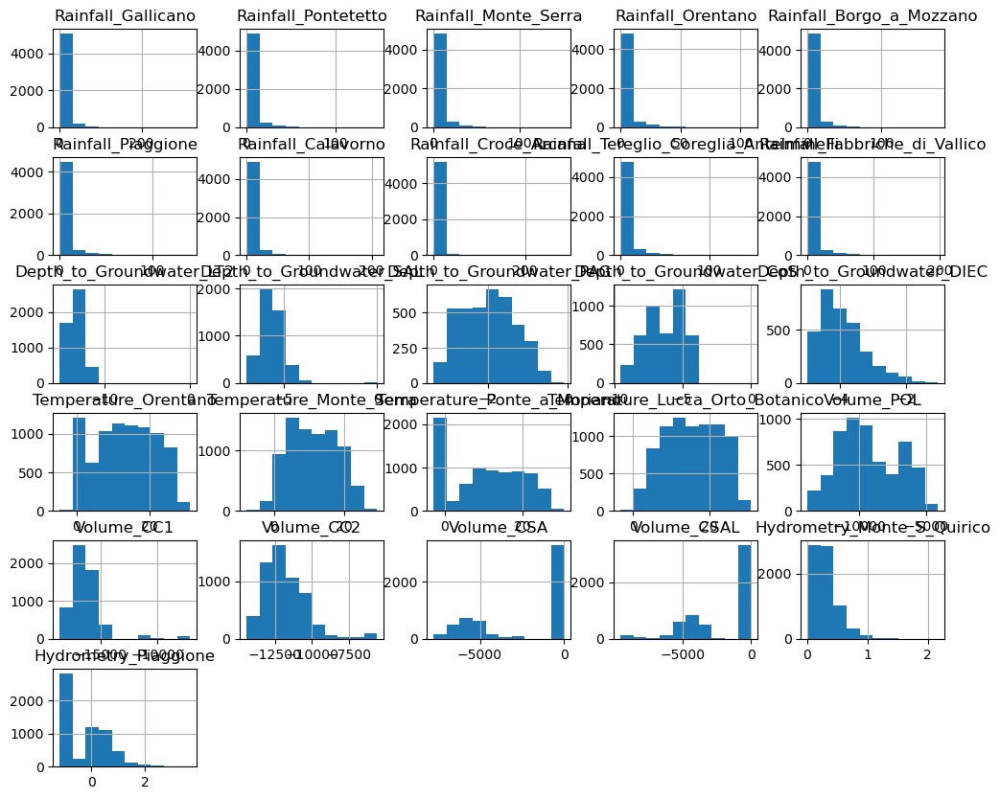

In [14]:
df_aa.hist(figsize=(12,10))
plt.show()

In [15]:
df_aa.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8154 entries, 0 to 8153
Data columns (total 27 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Date                                     8154 non-null   object 
 1   Rainfall_Gallicano                       5295 non-null   float64
 2   Rainfall_Pontetetto                      5295 non-null   float64
 3   Rainfall_Monte_Serra                     5289 non-null   float64
 4   Rainfall_Orentano                        5295 non-null   float64
 5   Rainfall_Borgo_a_Mozzano                 5295 non-null   float64
 6   Rainfall_Piaggione                       4930 non-null   float64
 7   Rainfall_Calavorno                       5295 non-null   float64
 8   Rainfall_Croce_Arcana                    5295 non-null   float64
 9   Rainfall_Tereglio_Coreglia_Antelminelli  5295 non-null   float64
 10  Rainfall_Fabbriche_di_Vallico            5295 no

__Observaciones:__  
Como se puede observar en la visualización anterior, en algunas variables existen outliers, por lo que se analizará que tan viable es coservarlos.

#### __Análisis Bivariado.__ 

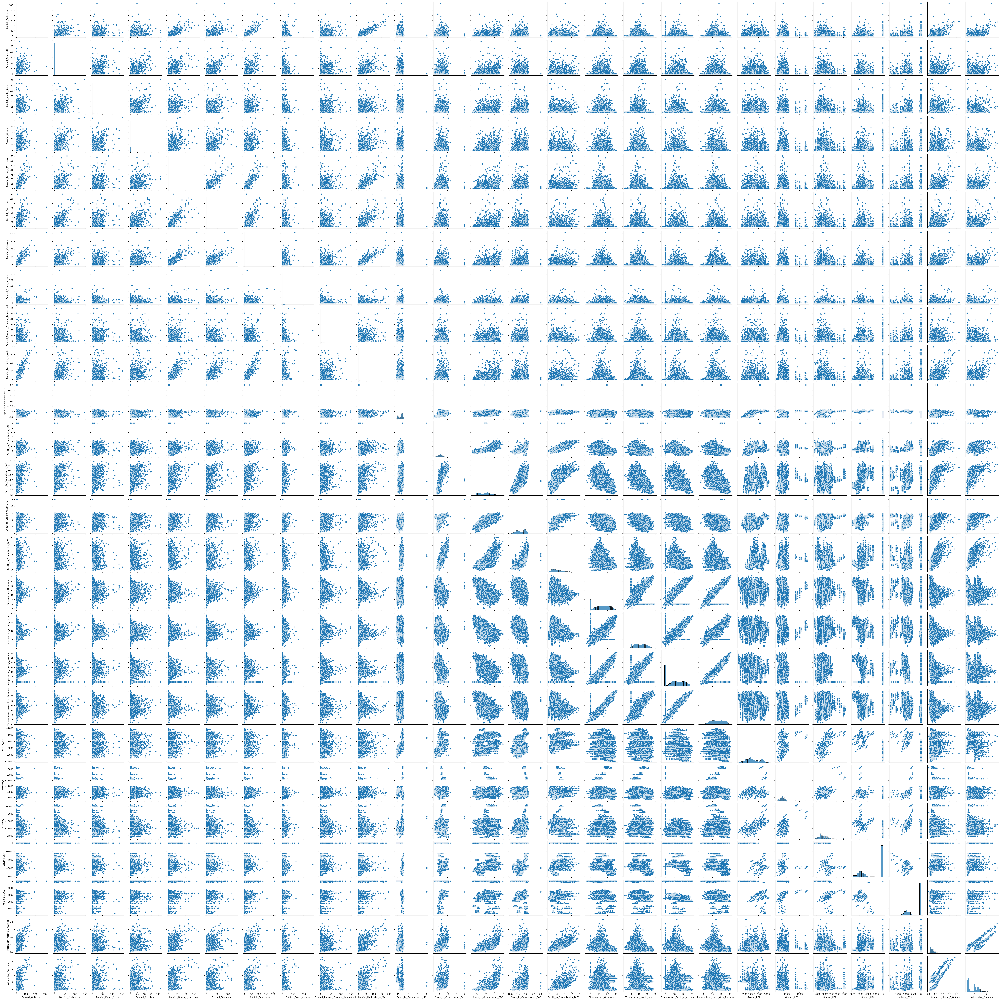

In [16]:
sns.pairplot(df_aa)

__Observaciones:__. 
Se puede observar que hay varias tendencias en los datos, se analizará de qué tipo son más adelante.

#### __Correlación:__

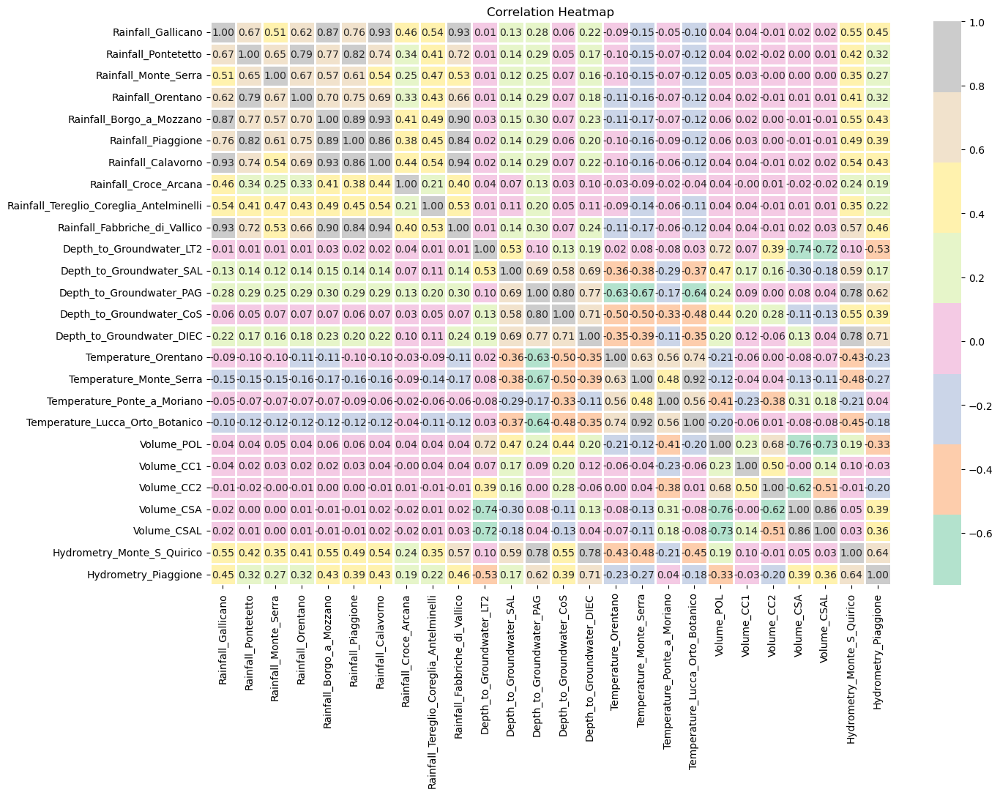

In [17]:
plt.figure(figsize=(15, 10))
df_aa_wd = df_aa.drop(['Date'], axis=1)
sns.heatmap(df_aa_wd.corr(), annot=True, fmt='.2f', cmap='Pastel2', linewidths=2)

plt.title('Correlation Heatmap')
plt.show()

### __Acuífero Doganella__. 
---

#### __Análisis Univariable__

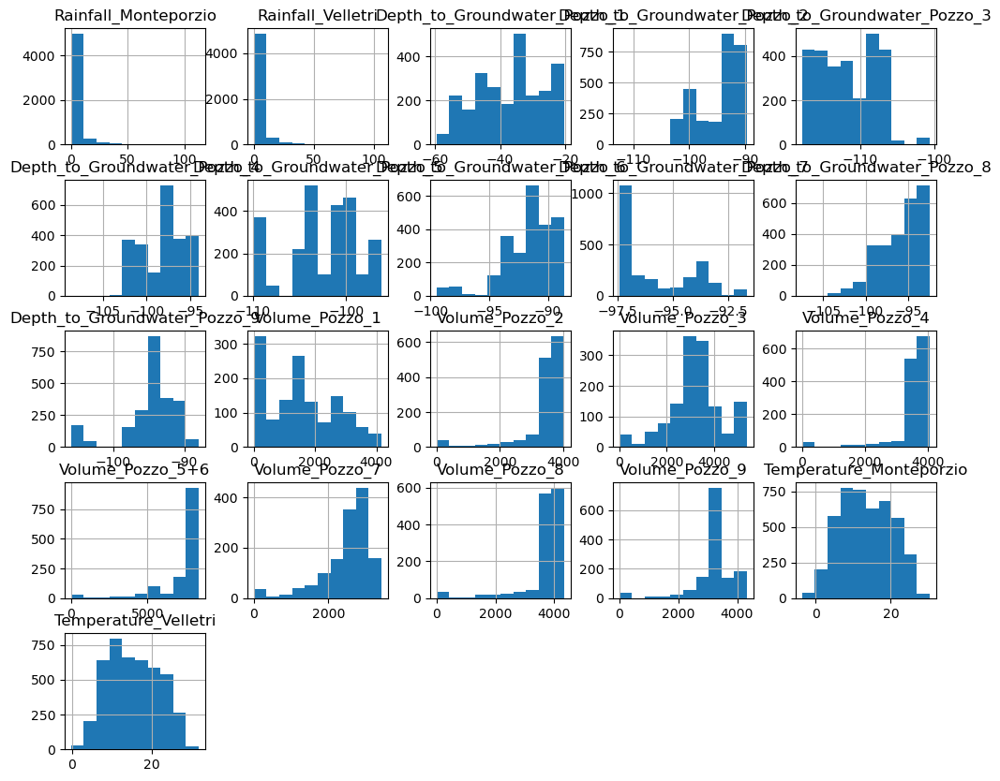

In [18]:
df_ad.hist(figsize=(12,10))
plt.show()

#### __Análisis Bivariado__

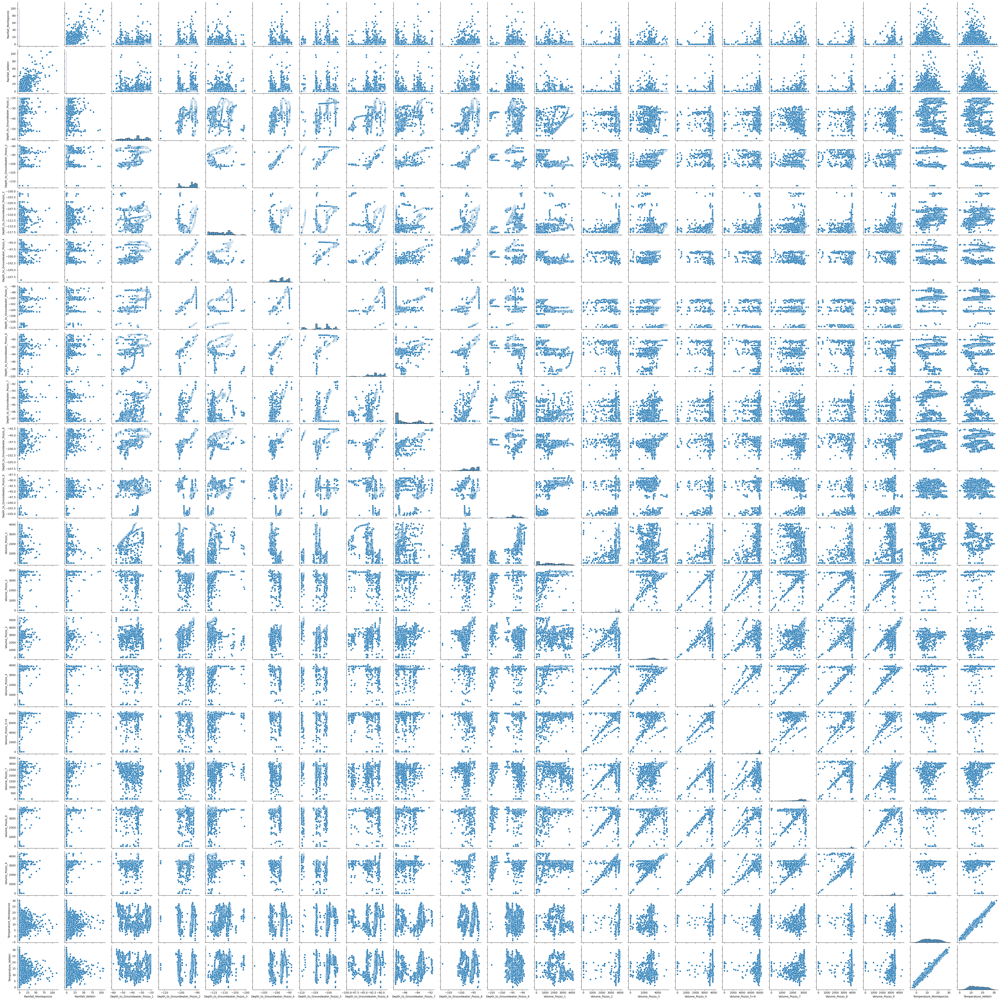

In [19]:
sns.pairplot(df_ad)

#### __Correlación__

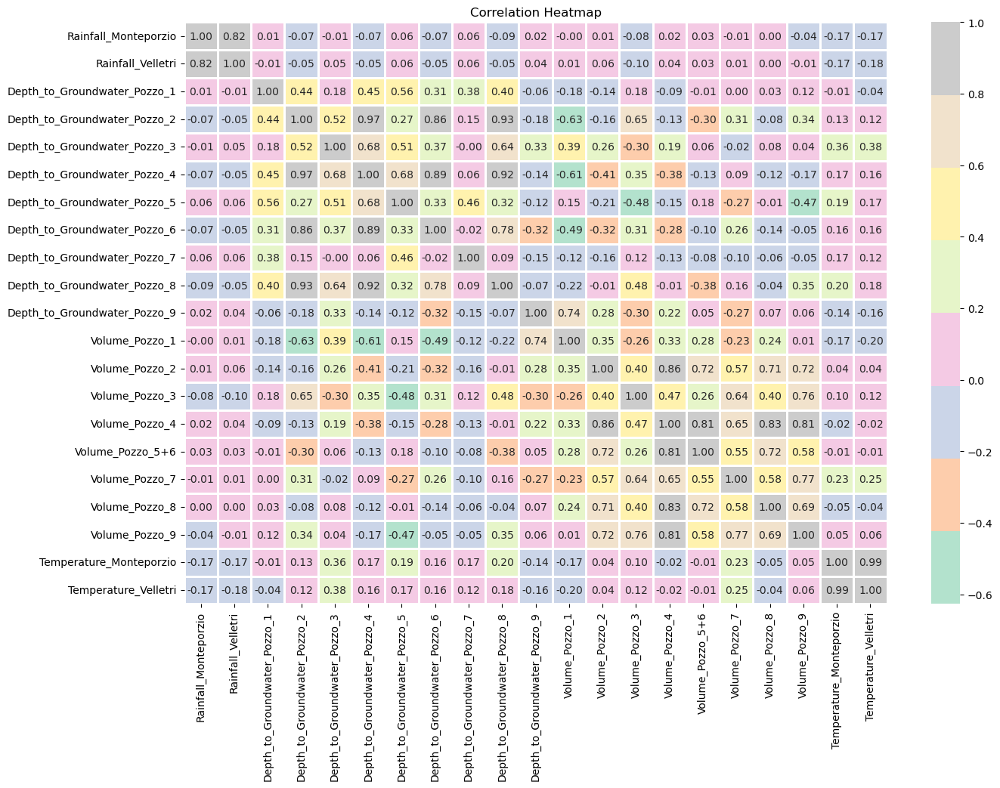

In [20]:
plt.figure(figsize=(15, 10))
df_wd_l = df_ad.drop(['Date'], axis=1)
sns.heatmap(df_wd_l.corr(), annot=True, fmt='.2f', cmap='Pastel2', linewidths=2)

plt.title('Correlation Heatmap')
plt.show()

### __Acuífero Luco__. 
---

#### __Análisis Univariado__

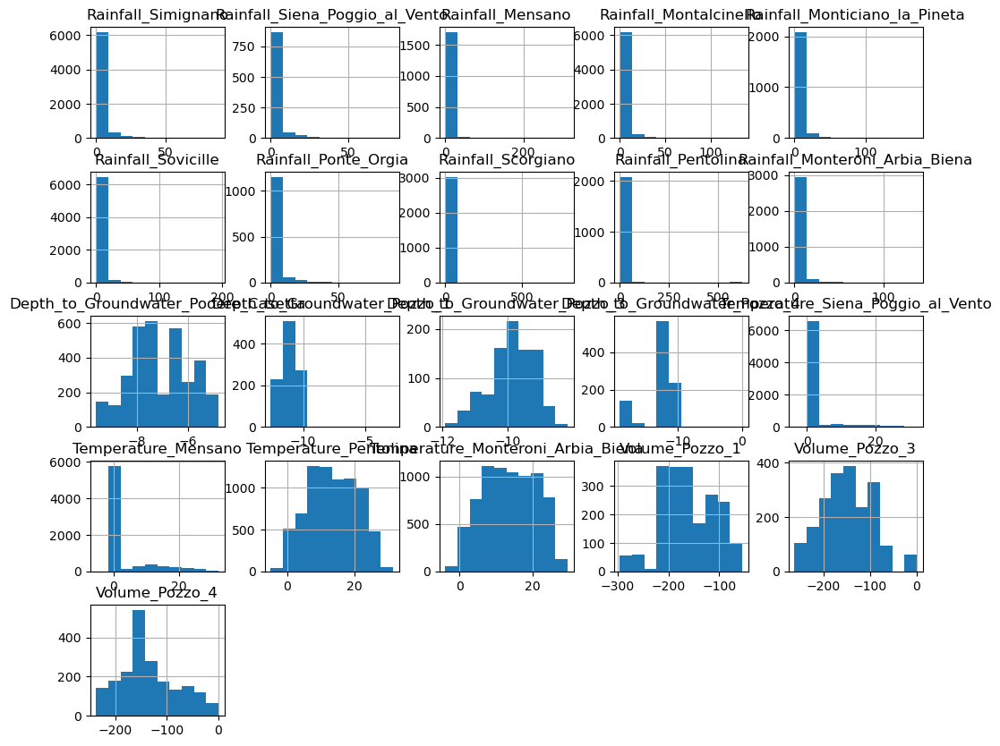

In [21]:
df_al.hist(figsize=(12,10))
plt.show()

#### __Análisis Bivariado.__

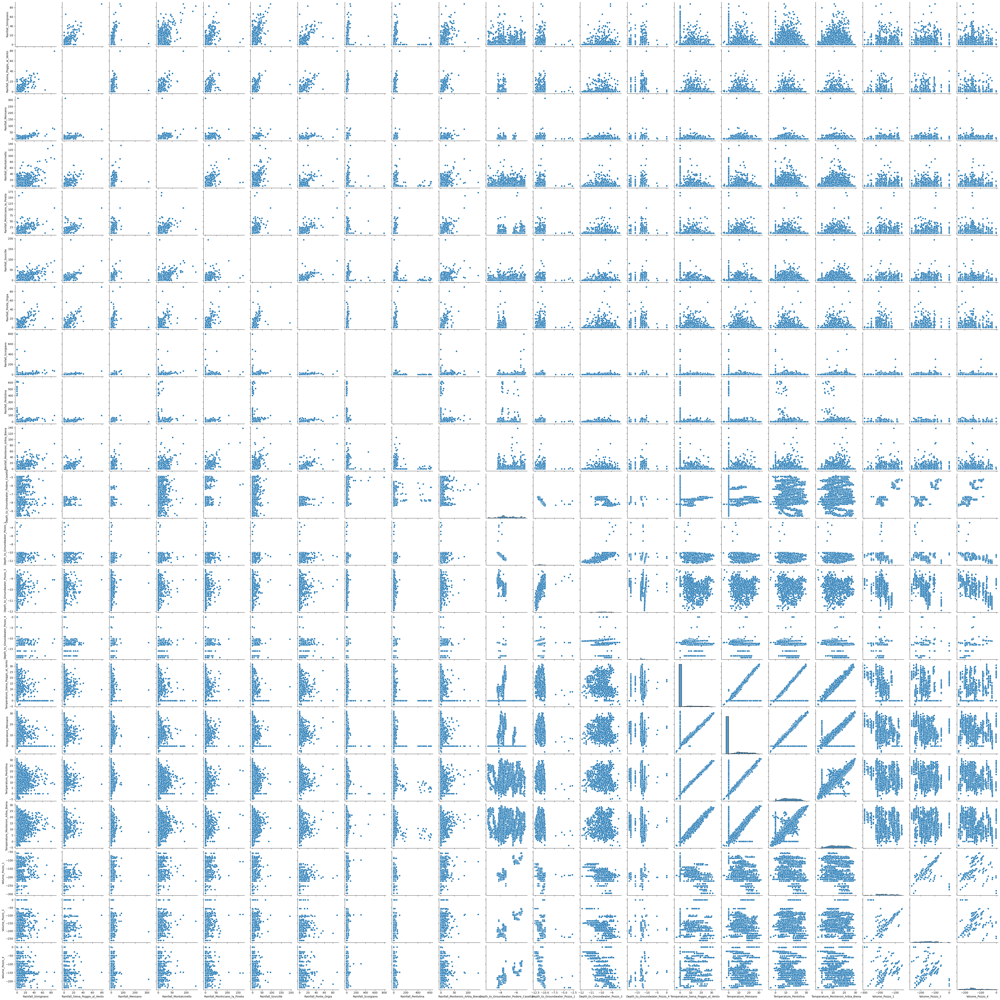

In [22]:
sns.pairplot(df_al)

#### __Correlación.__

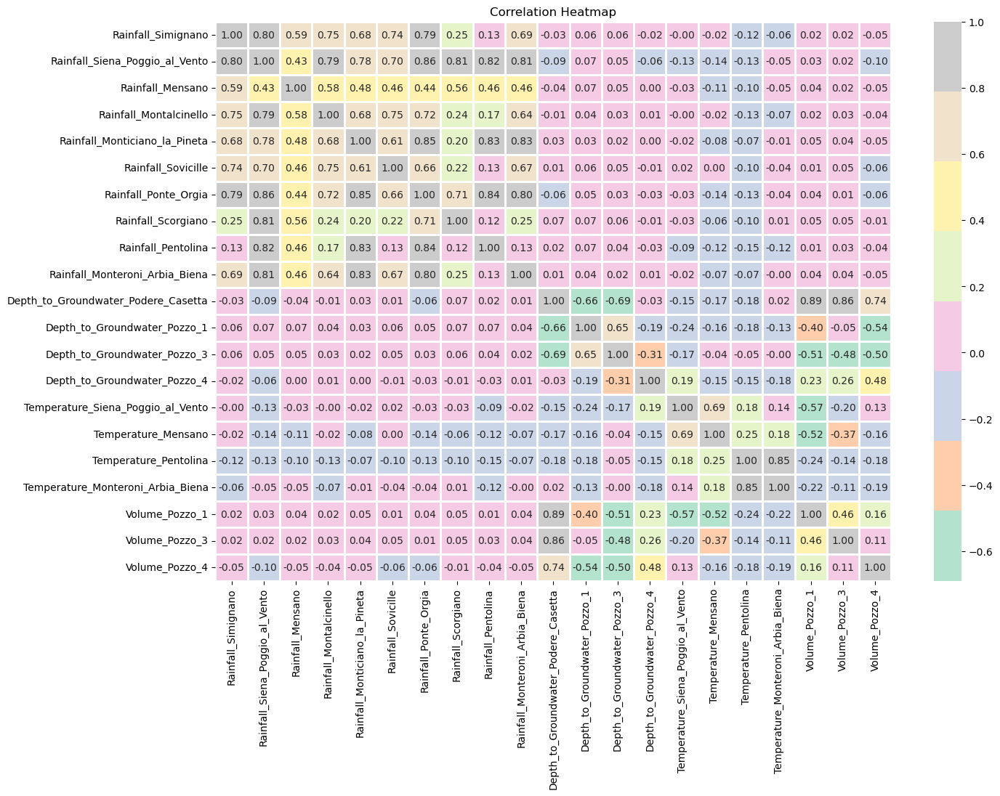

In [23]:
plt.figure(figsize=(15, 10))
df_wd_m = df_al.drop(['Date'], axis=1)
sns.heatmap(df_wd_m.corr(), annot=True, fmt='.2f', cmap='Pastel2', linewidths=2)

plt.title('Correlation Heatmap')
plt.show()

### __Acuífero Petrignano__. 
---

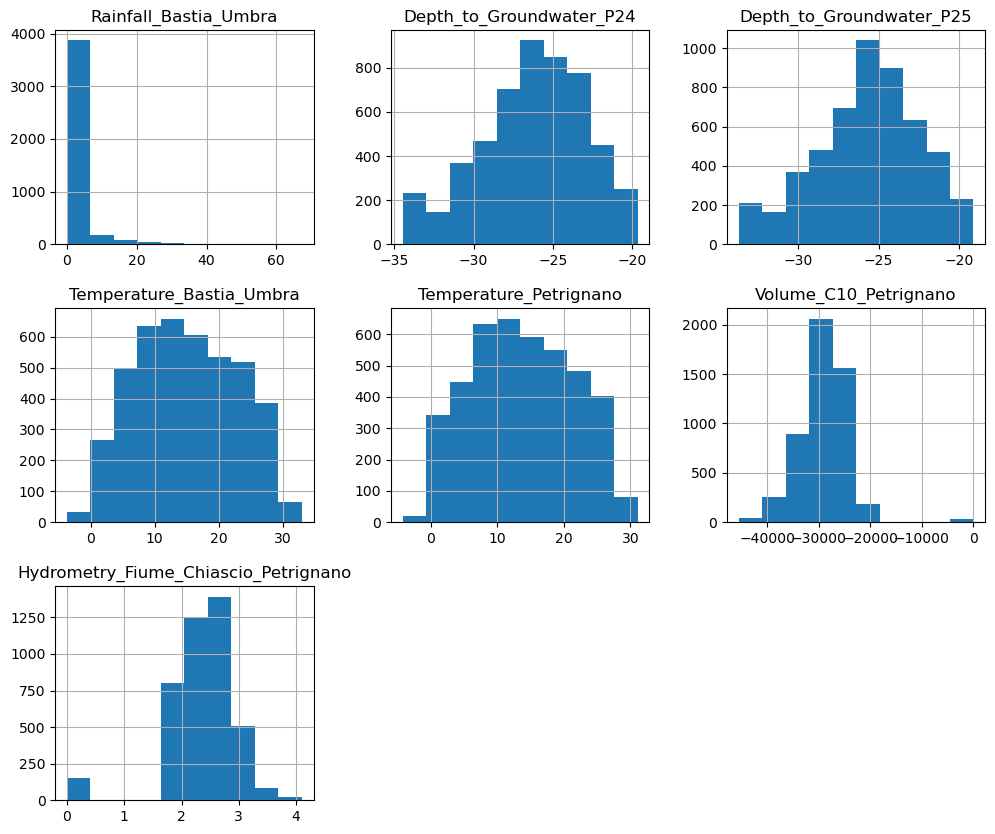

In [24]:
df_ap.hist(figsize=(12,10))
plt.show()

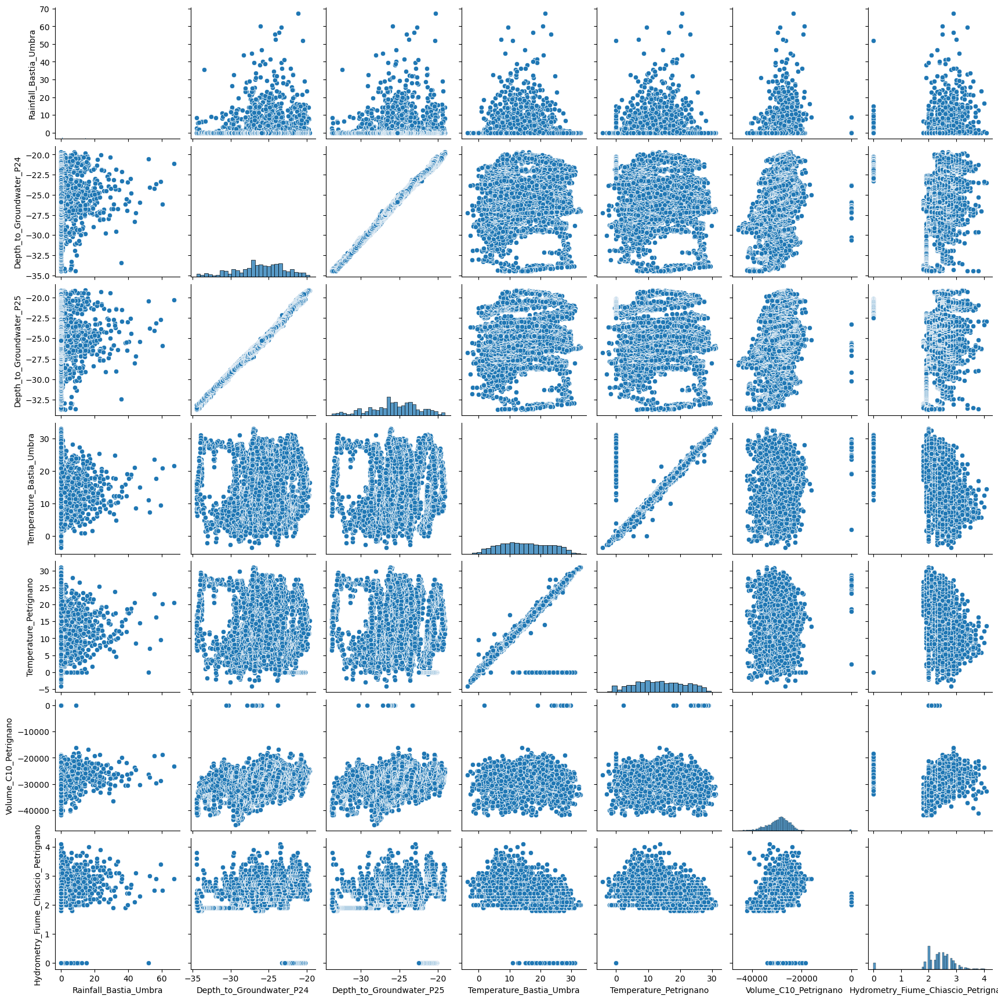

In [25]:
sns.pairplot(df_ap)

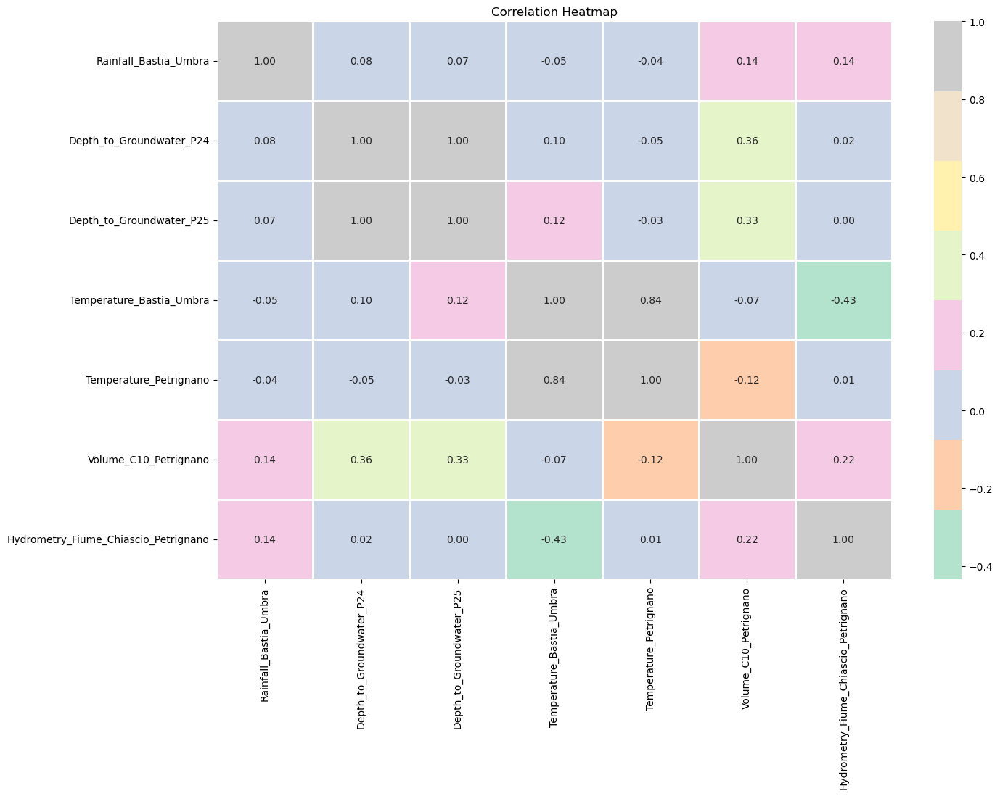

In [26]:
plt.figure(figsize=(15, 10))
df_wd_p = df_ap.drop(['Date'], axis=1)
sns.heatmap(df_wd_p.corr(), annot=True, fmt='.2f', cmap='Pastel2', linewidths=2)

plt.title('Correlation Heatmap')
plt.show()

# 3. Limpieza de Datos (Data Cleansing). 

### Fusionar dataframes. 

In [27]:
# Fusión de los DataFrames
df_first_fusion = pd.merge(df_aa, df_ad, on='Date', how='outer')
df_first_fusion.head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Volume_Pozzo_1,Volume_Pozzo_2,Volume_Pozzo_3,Volume_Pozzo_4,Volume_Pozzo_5+6,Volume_Pozzo_7,Volume_Pozzo_8,Volume_Pozzo_9,Temperature_Monteporzio,Temperature_Velletri
0,01/01/1999,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,01/01/2001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,01/01/2002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,01/01/2003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [28]:
# Fusión de los DataFrames
df_second_fusion = pd.merge(df_first_fusion, df_al, on='Date', how='outer')
df_second_fusion.head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Depth_to_Groundwater_Pozzo_1_y,Depth_to_Groundwater_Pozzo_3_y,Depth_to_Groundwater_Pozzo_4_y,Temperature_Siena_Poggio_al_Vento,Temperature_Mensano,Temperature_Pentolina,Temperature_Monteroni_Arbia_Biena,Volume_Pozzo_1_y,Volume_Pozzo_3_y,Volume_Pozzo_4_y
0,01/01/1999,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,5.50,0.80,NaN,NaN,NaN
2,01/01/2001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,5.15,2.65,NaN,NaN,NaN
3,01/01/2002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,0.00,0.45,NaN,NaN,NaN
4,01/01/2003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,8.95,9.50,NaN,NaN,NaN


In [29]:
# Fusión de los DataFrames
df_a = pd.merge(df_second_fusion, df_ap, on='Date', how='outer')
df_a.head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Volume_Pozzo_1_y,Volume_Pozzo_3_y,Volume_Pozzo_4_y,Rainfall_Bastia_Umbra,Depth_to_Groundwater_P24,Depth_to_Groundwater_P25,Temperature_Bastia_Umbra,Temperature_Petrignano,Volume_C10_Petrignano,Hydrometry_Fiume_Chiascio_Petrignano
0,01/01/1999,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,01/01/2001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,01/01/2002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,01/01/2003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [30]:
# Se toma un sample del dataframe para trabajar con un conjunto de datos más manejable
df_a = df_a.sample(n=1000, random_state=42)

In [31]:
df_a.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1000 entries, 4342 to 665
Data columns (total 76 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Date                                     1000 non-null   object 
 1   Rainfall_Gallicano                       646 non-null    float64
 2   Rainfall_Pontetetto                      646 non-null    float64
 3   Rainfall_Monte_Serra                     645 non-null    float64
 4   Rainfall_Orentano                        646 non-null    float64
 5   Rainfall_Borgo_a_Mozzano                 646 non-null    float64
 6   Rainfall_Piaggione                       602 non-null    float64
 7   Rainfall_Calavorno                       646 non-null    float64
 8   Rainfall_Croce_Arcana                    646 non-null    float64
 9   Rainfall_Tereglio_Coreglia_Antelminelli  646 non-null    float64
 10  Rainfall_Fabbriche_di_Vallico            646 non-nu

### Tratamiento de valores nulos. 

In [32]:
# Eliminación de valores nulos en DataFrames
def eliminated_nulls(df):
    fecha_actual = datetime.now()
    df.fillna(0, inplace=True)
    df['Date'].fillna(fecha_actual, inplace=True)

eliminated_nulls(df_a)


/var/folders/z5/1t80mr5s6n10j0fkr7bb6x6c0000gn/T/ipykernel_5327/1747201607.py:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Date'].fillna(fecha_actual, inplace=True)


### Tratamiento de Outliers. 

Función para encontrar columnas con Outliers:


In [33]:
def outliers_column(df):
    columnas_con_outliers = []
    
    # Iterar sobre cada columna del DataFrame
    for col in df.columns:
        # Asegurarse de que la columna es numérica
        if pd.api.types.is_numeric_dtype(df[col]):
            q1 = df[col].quantile(0.25)
            q3 = df[col].quantile(0.75)
            iqr = q3 - q1
            
            # Definir los límites para los outliers
            limite_inferior = q1 - 1.5 * iqr
            limite_superior = q3 + 1.5 * iqr
            
            # Verificar si hay algún valor atípico en la columna
            outliers_presentes = ((df[col] < limite_inferior) | (df[col] > limite_superior)).any()
            
            # Si se encuentran outliers, agregar el nombre de la columna a la lista
            if outliers_presentes:
                columnas_con_outliers.append(col)
    
    return columnas_con_outliers

#### Outliers. 

In [34]:
a_oc = outliers_column(df_a)
print(f"Columnas con outliers en df_aa: {a_oc}")
df_a_oc = df_a[a_oc]

Columnas con outliers en df_aa: ['Rainfall_Gallicano', 'Rainfall_Pontetetto', 'Rainfall_Monte_Serra', 'Rainfall_Orentano', 'Rainfall_Borgo_a_Mozzano', 'Rainfall_Piaggione', 'Rainfall_Calavorno', 'Rainfall_Croce_Arcana', 'Rainfall_Tereglio_Coreglia_Antelminelli', 'Rainfall_Fabbriche_di_Vallico', 'Volume_CSAL', 'Hydrometry_Monte_S_Quirico', 'Hydrometry_Piaggione', 'Rainfall_Monteporzio', 'Rainfall_Velletri', 'Volume_Pozzo_1_x', 'Volume_Pozzo_2', 'Volume_Pozzo_3_x', 'Volume_Pozzo_4_x', 'Volume_Pozzo_5+6', 'Volume_Pozzo_7', 'Volume_Pozzo_8', 'Volume_Pozzo_9', 'Rainfall_Simignano', 'Rainfall_Siena_Poggio_al_Vento', 'Rainfall_Mensano', 'Rainfall_Montalcinello', 'Rainfall_Monticiano_la_Pineta', 'Rainfall_Sovicille', 'Rainfall_Ponte_Orgia', 'Rainfall_Scorgiano', 'Rainfall_Pentolina', 'Rainfall_Monteroni_Arbia_Biena', 'Depth_to_Groundwater_Pozzo_1_y', 'Depth_to_Groundwater_Pozzo_3_y', 'Depth_to_Groundwater_Pozzo_4_y', 'Temperature_Siena_Poggio_al_Vento', 'Temperature_Mensano', 'Volume_Pozzo_1_y

Función para obtener gráfico de todos los outliers:

In [35]:
def plot_outliers_boxplots(df, columns):
    # 1. Contar el número de columnas con outliers
    num_cols = len(columns)

    # 2. Definir la disposición de los subplots (ej. 2 filas, 2 columnas)
    # Esto es flexible, puedes ajustarlo según tus necesidades
    num_filas = 4
    num_columnas = int(np.ceil(num_cols / num_filas))

    # 3. Crear la figura y los subplots
    fig, axes = plt.subplots(num_filas, num_columnas, figsize=(15, 10))

    # Aplanar el array de ejes para iterar fácilmente
    axes = axes.flatten()

    # 4. Iterar sobre las columnas y dibujar el box plot en cada subplot
    for i, col in enumerate(columns):
        ax = axes[i]
        ax.boxplot(df[col], vert=False) # vert=False para que sean horizontales
        ax.set_title(f'{col}')
        ax.set_xlabel('Valores')
        ax.grid(True, linestyle='--', alpha=0.6)

    # Ocultar los subplots que no se usen (si los hay)
    for i in range(num_cols, len(axes)):
        axes[i].axis('off')

    # Ajustar el espaciado entre subplots
    plt.tight_layout()
    plt.show()

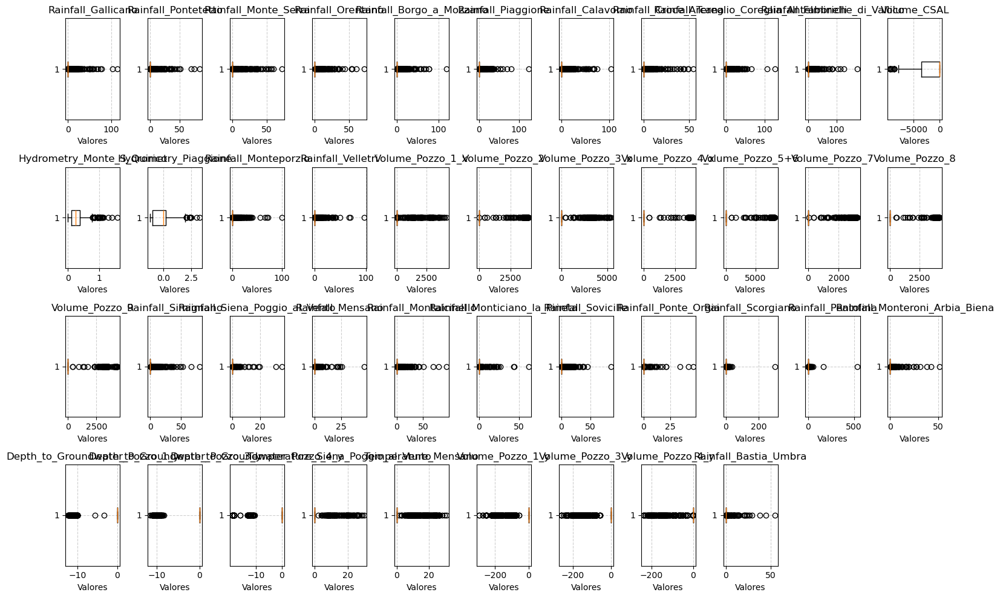

In [36]:
plot_outliers_boxplots(df_a, a_oc)

### Cambio de tipo de datos (features). 

In [37]:
# Cambiar fecha de string a datetime
df_a['Date'] = pd.to_datetime(df_a['Date'], format='%d/%m/%Y', errors='coerce')
df_a.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1000 entries, 4342 to 665
Data columns (total 76 columns):
 #   Column                                   Non-Null Count  Dtype         
---  ------                                   --------------  -----         
 0   Date                                     1000 non-null   datetime64[ns]
 1   Rainfall_Gallicano                       1000 non-null   float64       
 2   Rainfall_Pontetetto                      1000 non-null   float64       
 3   Rainfall_Monte_Serra                     1000 non-null   float64       
 4   Rainfall_Orentano                        1000 non-null   float64       
 5   Rainfall_Borgo_a_Mozzano                 1000 non-null   float64       
 6   Rainfall_Piaggione                       1000 non-null   float64       
 7   Rainfall_Calavorno                       1000 non-null   float64       
 8   Rainfall_Croce_Arcana                    1000 non-null   float64       
 9   Rainfall_Tereglio_Coreglia_Antelminelli  100

# 4. Ingeniería de Características (Feature Engineering). 

### __Comparación de features entre acuíferos.__. 
En la siguiente tabla, se pueden observar las features en común para todos los acuíferos.

| Nombre de Acuífero | Features                                                            | Features en común                       |
|--------------------|---------------------------------------------------------------------|-----------------------------------------|
| Aquifer Auser | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Depth_to_Groundwater<br>-Volume<br>-Hydrometry | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Volume             |
| Aquifer Doganella | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Volume                                    | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Volume               |
| Aquifer Luco | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Volume     | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Volume              |
| Aquifer Petrignano | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Volume<br>-Hydrometry      | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Volume |

Como se puede observar en la tabla, se identificaron las variables que se repiten en cada uno de los acuíferos.

## Transformación de formato (Wide -> Long). 

Al realizar el EDA inicial, se identificó que existen variables (features) que representan el mismo valor, pero diferente ubicación, por ejemplo, la variable __Rainfall__ esta repetida varias veces en varias ubicaciones, es por esto que se decidirá cambiar el formato del Dataframe, con el fin de obtener una sola variable, esto también ayudará a que nuestra variable target __Volume__ sea correctamente tratada.

Función general para realizar transformación de formato Wide -> Long.

In [38]:
# Transformación de formato (Wide -> Long)
def melt_multiple_variables(df, value_prefix_list, prefix_name):
    """
    Transforma un DataFrame de formato ancho a largo para múltiples variables.

    Args:
        df (pd.DataFrame): El DataFrame a transformar.
        value_prefix_list (list): Una lista de prefijos para las variables a derretir.
                                  Ej: ["Rainfall_", "Temperature_", "Hydrometry_"]

    Returns:
        pd.DataFrame: El DataFrame transformado en formato largo.
    """
    # Identificar todas las columnas que se van a derretir
    value_vars = []
    for prefix in value_prefix_list:
        value_vars.extend([col for col in df.columns if col.startswith(prefix)])
        
    # Identificar las columnas que no se van a derretir (id_vars)
    id_vars = [col for col in df.columns if col not in value_vars]
    
    # Realizar el melt
    df_long = df.melt(
        id_vars=id_vars,
        value_vars=value_vars,
        var_name=prefix_name + '_Location',
        value_name=prefix_name + '_Value'
    )
    
    # Separar la columna 'Measurement_Type' en 'Variable' y 'Ubicacion'
    # Esto asume que el formato es siempre 'Prefijo_Ubicacion'
    df_long[prefix_name + '_Location'] = df_long[prefix_name + '_Location'].apply(lambda x: x.split('_', 1)[1])
    #df_long[prefix_name + '_Location'] = df_long[prefix_name + '_Location'].apply(lambda x: x.split('_', 1)[1])
    
    # Opcional: Eliminar la columna intermedia 'Measurement_Type'
    #df_long = df_long.drop(columns=['Measurement_Type'])
    
    return df_long

In [39]:
df_a.head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Volume_Pozzo_1_y,Volume_Pozzo_3_y,Volume_Pozzo_4_y,Rainfall_Bastia_Umbra,Depth_to_Groundwater_P24,Depth_to_Groundwater_P25,Temperature_Bastia_Umbra,Temperature_Petrignano,Volume_C10_Petrignano,Hydrometry_Fiume_Chiascio_Petrignano
4342,2012-03-17,0.0,0.0,0.0,0.2,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.0,-29.30,-28.38,11.8,11.2,-35316.864,2.0
1203,2020-06-05,5.6,2.0,0.8,2.2,9.4,1.2,5.8,1.2,2.0,...,-125.506506,-147.012716,-49.136663,14.4,-24.91,-24.58,17.3,17.1,-25828.416,2.6
7127,2003-08-27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.0,0.00,0.00,0.0,0.0,0.000,0.0
1758,2016-07-07,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-163.353540,-154.175900,-136.928266,0.0,-24.47,-24.04,27.5,26.7,-26156.736,2.6
927,2012-06-04,22.0,0.4,0.0,0.0,4.8,4.6,16.6,1.6,29.0,...,0.000000,0.000000,0.000000,9.4,-29.35,-28.59,16.9,15.4,-25030.080,2.0


In [40]:
# Lista de todos los prefijos que quieres derretir
prefixes = ["Volume_"]

# Llama a la función una sola vez
df_aquifer_hydrology = melt_multiple_variables(df_a, prefixes, prefix_name="Volume")

print(df_aquifer_hydrology.head())

        Date  Rainfall_Gallicano  Rainfall_Pontetetto  Rainfall_Monte_Serra  \
0 2012-03-17                 0.0                  0.0                   0.0   
1 2020-06-05                 5.6                  2.0                   0.8   
2 2003-08-27                 0.0                  0.0                   0.0   
3 2016-07-07                 0.0                  0.0                   0.0   
4 2012-06-04                22.0                  0.4                   0.0   

   Rainfall_Orentano  Rainfall_Borgo_a_Mozzano  Rainfall_Piaggione  \
0                0.2                       0.0                 0.0   
1                2.2                       9.4                 1.2   
2                0.0                       0.0                 0.0   
3                0.0                       0.0                 0.0   
4                0.0                       4.8                 4.6   

   Rainfall_Calavorno  Rainfall_Croce_Arcana  \
0                 0.0                    0.0   
1       

In [41]:
# Lista de todos los prefijos que quieres derretir
prefixes_r = ["Rainfall_"]

# Llama a la función una sola vez
df_aquifer_hydrology = melt_multiple_variables(df_aquifer_hydrology, prefixes_r, prefix_name="Rainfall")

print(df_aquifer_hydrology.head())

        Date  Depth_to_Groundwater_LT2  Depth_to_Groundwater_SAL  \
0 2012-03-17                       0.0                     -6.43   
1 2020-06-05                     -12.2                      0.00   
2 2003-08-27                       0.0                      0.00   
3 2016-07-07                       0.0                     -5.64   
4 2012-06-04                     -13.3                     -6.00   

   Depth_to_Groundwater_PAG  Depth_to_Groundwater_CoS  \
0                     -2.78                     -7.68   
1                     -2.10                      0.00   
2                      0.00                      0.00   
3                     -2.43                     -6.44   
4                     -2.48                     -6.66   

   Depth_to_Groundwater_DIEC  Temperature_Orentano  Temperature_Monte_Serra  \
0                      -4.71                 10.85                     8.35   
1                      -2.95                 19.70                    13.80   
2          

In [42]:
prefixes_h = ["Hydrometry_"]

# Llama a la función una sola vez
df_aquifer_hydrology = melt_multiple_variables(df_aquifer_hydrology, prefixes_h, prefix_name="Hydrometry")

print(df_aquifer_hydrology.head())

        Date  Depth_to_Groundwater_LT2  Depth_to_Groundwater_SAL  \
0 2012-03-17                       0.0                     -6.43   
1 2020-06-05                     -12.2                      0.00   
2 2003-08-27                       0.0                      0.00   
3 2016-07-07                       0.0                     -5.64   
4 2012-06-04                     -13.3                     -6.00   

   Depth_to_Groundwater_PAG  Depth_to_Groundwater_CoS  \
0                     -2.78                     -7.68   
1                     -2.10                      0.00   
2                      0.00                      0.00   
3                     -2.43                     -6.44   
4                     -2.48                     -6.66   

   Depth_to_Groundwater_DIEC  Temperature_Orentano  Temperature_Monte_Serra  \
0                      -4.71                 10.85                     8.35   
1                      -2.95                 19.70                    13.80   
2          

In [43]:
prefixes_t = ["Temperature_"]

# Llama a la función una sola vez
df_aquifer_hydrology = melt_multiple_variables(df_aquifer_hydrology, prefixes_t, prefix_name="Temperature")

print(df_aquifer_hydrology.head())

        Date  Depth_to_Groundwater_LT2  Depth_to_Groundwater_SAL  \
0 2012-03-17                       0.0                     -6.43   
1 2020-06-05                     -12.2                      0.00   
2 2003-08-27                       0.0                      0.00   
3 2016-07-07                       0.0                     -5.64   
4 2012-06-04                     -13.3                     -6.00   

   Depth_to_Groundwater_PAG  Depth_to_Groundwater_CoS  \
0                     -2.78                     -7.68   
1                     -2.10                      0.00   
2                      0.00                      0.00   
3                     -2.43                     -6.44   
4                     -2.48                     -6.66   

   Depth_to_Groundwater_DIEC  Depth_to_Groundwater_Pozzo_1_x  \
0                      -4.71                            0.00   
1                      -2.95                          -51.05   
2                       0.00                            

In [44]:
df_aquifer_hydrology.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14076000 entries, 0 to 14075999
Data columns (total 29 columns):
 #   Column                               Dtype         
---  ------                               -----         
 0   Date                                 datetime64[ns]
 1   Depth_to_Groundwater_LT2             float64       
 2   Depth_to_Groundwater_SAL             float64       
 3   Depth_to_Groundwater_PAG             float64       
 4   Depth_to_Groundwater_CoS             float64       
 5   Depth_to_Groundwater_DIEC            float64       
 6   Depth_to_Groundwater_Pozzo_1_x       float64       
 7   Depth_to_Groundwater_Pozzo_2         float64       
 8   Depth_to_Groundwater_Pozzo_3_x       float64       
 9   Depth_to_Groundwater_Pozzo_4_x       float64       
 10  Depth_to_Groundwater_Pozzo_5         float64       
 11  Depth_to_Groundwater_Pozzo_6         float64       
 12  Depth_to_Groundwater_Pozzo_7         float64       
 13  Depth_to_Groundwater_Pozz

In [45]:
# Se toma un sample del dataframe para trabajar con un conjunto de datos más manejable
df_aquifer_hydrology = df_aquifer_hydrology.sample(n=1000, random_state=42)

In [46]:
prefixes_t = ["Depth_to_Groundwater_"]

# Llama a la función una sola vez
df_aquifer_hydrology = melt_multiple_variables(df_aquifer_hydrology, prefixes_t, prefix_name="Depth_to_Groundwater")

print(df_aquifer_hydrology.head())

        Date Volume_Location  Volume_Value               Rainfall_Location  \
0 2018-01-20  C10_Petrignano    -28050.624                       Calavorno   
1 2008-03-18       Pozzo_1_y         0.000            Monticiano_la_Pineta   
2 1998-04-18       Pozzo_3_y         0.000            Fabbriche_di_Vallico   
3 2017-04-28         Pozzo_7      3065.940  Tereglio_Coreglia_Antelminelli   
4 2006-10-03             CSA         0.000                      Pontetetto   

   Rainfall_Value Hydrometry_Location  Hydrometry_Value Temperature_Location  \
0             2.6           Piaggione             -0.54          Monte_Serra   
1             0.0     Monte_S_Quirico              0.36             Orentano   
2             0.0           Piaggione              0.00              Mensano   
3             0.0     Monte_S_Quirico              0.31             Velletri   
4             0.0           Piaggione              0.11  Lucca_Orto_Botanico   

   Temperature_Value Depth_to_Groundwater_Location

### Variables categóricas a variables numéricas.

Ahora que se transformaron las columnas de los dataset, se convertirán las variables categóricas a variables numéricas, con el fin de facilitar el análisis.

In [47]:
def transform_locations_to_numbers(df, column_name):
    """
    Mapea las ubicaciones de lluvia a números únicos.
    
    Args:
        df (DataFrame): DataFrame que contiene la columna de ubicaciones de lluvia.
        column_name (str): Nombre de la columna que contiene las ubicaciones de lluvia.
    
    Returns:
        DataFrame: DataFrame con la columna de ubicaciones mapeada a números.
    """
    all_locations = df[column_name].unique()
    locations_map = {}
    num = 1
    
    for location in all_locations:
        locations_map[location] = num
        num += 1

    print(f"Ubicaciones de lluvia mapeadas: {locations_map}")

    # Mapeo de ubicaciones de lluvia a números
    df[column_name] = df[column_name].map(locations_map)
    
    return df

In [48]:
df_aquifer_hydrology.head()

,Date,Volume_Location,Volume_Value,Rainfall_Location,Rainfall_Value,Hydrometry_Location,Hydrometry_Value,Temperature_Location,Temperature_Value,Depth_to_Groundwater_Location,Depth_to_Groundwater_Value
0,2018-01-20,C10_Petrignano,-28050.624,Calavorno,2.6,Piaggione,-0.54,Monte_Serra,4.7,to_Groundwater_LT2,-12.77
1,2008-03-18,Pozzo_1_y,0.000,Monticiano_la_Pineta,0.0,Monte_S_Quirico,0.36,Orentano,12.9,to_Groundwater_LT2,-14.48
2,1998-04-18,Pozzo_3_y,0.000,Fabbriche_di_Vallico,0.0,Piaggione,0.00,Mensano,0.0,to_Groundwater_LT2,0.00
3,2017-04-28,Pozzo_7,3065.940,Tereglio_Coreglia_Antelminelli,0.0,Monte_S_Quirico,0.31,Velletri,0.0,to_Groundwater_LT2,-12.21
4,2006-10-03,CSA,0.000,Pontetetto,0.0,Piaggione,0.11,Lucca_Orto_Botanico,21.6,to_Groundwater_LT2,-15.12


In [49]:
# Aplicar la transformación a df_aa
df_aquifer_hydrology = transform_locations_to_numbers(df_aquifer_hydrology, 'Rainfall_Location')
df_aquifer_hydrology = transform_locations_to_numbers(df_aquifer_hydrology, 'Temperature_Location')
df_aquifer_hydrology = transform_locations_to_numbers(df_aquifer_hydrology, 'Hydrometry_Location')
df_aquifer_hydrology = transform_locations_to_numbers(df_aquifer_hydrology, 'Depth_to_Groundwater_Location')
df_aquifer_hydrology = transform_locations_to_numbers(df_aquifer_hydrology, 'Volume_Location')

Ubicaciones de lluvia mapeadas: {'Calavorno': 1, 'Monticiano_la_Pineta': 2, 'Fabbriche_di_Vallico': 3, 'Tereglio_Coreglia_Antelminelli': 4, 'Pontetetto': 5, 'Gallicano': 6, 'Ponte_Orgia': 7, 'Monte_Serra': 8, 'Piaggione': 9, 'Simignano': 10, 'Monteroni_Arbia_Biena': 11, 'Borgo_a_Mozzano': 12, 'Bastia_Umbra': 13, 'Velletri': 14, 'Sovicille': 15, 'Orentano': 16, 'Pentolina': 17, 'Croce_Arcana': 18, 'Montalcinello': 19, 'Mensano': 20, 'Siena_Poggio_al_Vento': 21, 'Monteporzio': 22, 'Scorgiano': 23}
Ubicaciones de lluvia mapeadas: {'Monte_Serra': 1, 'Orentano': 2, 'Mensano': 3, 'Velletri': 4, 'Lucca_Orto_Botanico': 5, 'Bastia_Umbra': 6, 'Pentolina': 7, 'Monteporzio': 8, 'Petrignano': 9, 'Ponte_a_Moriano': 10, 'Monteroni_Arbia_Biena': 11, 'Siena_Poggio_al_Vento': 12}
Ubicaciones de lluvia mapeadas: {'Piaggione': 1, 'Monte_S_Quirico': 2, 'Fiume_Chiascio_Petrignano': 3}
Ubicaciones de lluvia mapeadas: {'to_Groundwater_LT2': 1, 'to_Groundwater_SAL': 2, 'to_Groundwater_PAG': 3, 'to_Groundwater_

### Encontrar variables que se volvieron constantes.

Con el fin de identificar variables que se volvieron constantes, se buscarán aquellas variables cuya desviación estándar sea 0.

In [50]:
df_aquifer_hydrology.describe()

,Date,Volume_Location,Volume_Value,Rainfall_Location,Rainfall_Value,Hydrometry_Location,Hydrometry_Value,Temperature_Location,Temperature_Value,Depth_to_Groundwater_Location,Depth_to_Groundwater_Value
count,20000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000
mean,2009-09-12 22:45:07.200000,9.066000,-2552.224354,12.038000,1.869800,1.996000,0.440330,6.490000,9.090050,10.500000,-16.300932
min,1998-03-12 00:00:00,1.000000,-43208.640000,1.000000,0.000000,1.000000,-1.170000,1.000000,-2.450000,1.000000,-117.750000
25%,2004-04-26 00:00:00,5.000000,-84.941103,6.000000,0.000000,1.000000,0.000000,4.000000,0.000000,5.750000,-11.300000
50%,2009-12-20 00:00:00,9.000000,0.000000,12.000000,0.000000,2.000000,0.120000,6.000000,8.450000,10.500000,0.000000
75%,2015-03-20 00:00:00,13.000000,0.000000,18.000000,0.000000,3.000000,0.580000,9.000000,16.485000,15.250000,0.000000
max,2020-06-21 00:00:00,17.000000,8037.540000,23.000000,96.400000,3.000000,3.300000,12.000000,29.600000,20.000000,0.000000
std,NaN,4.721097,6856.292645,6.620933,7.081734,0.819767,1.056042,3.439257,8.664474,5.766425,32.768512


In [51]:
df_aquifer_hydrology.drop(columns=['Rainfall_Location', 'Temperature_Location', 'Hydrometry_Location', 'Depth_to_Groundwater_Location', 'Volume_Location'], inplace=True)

# 5. EDA refinado y visualización. 

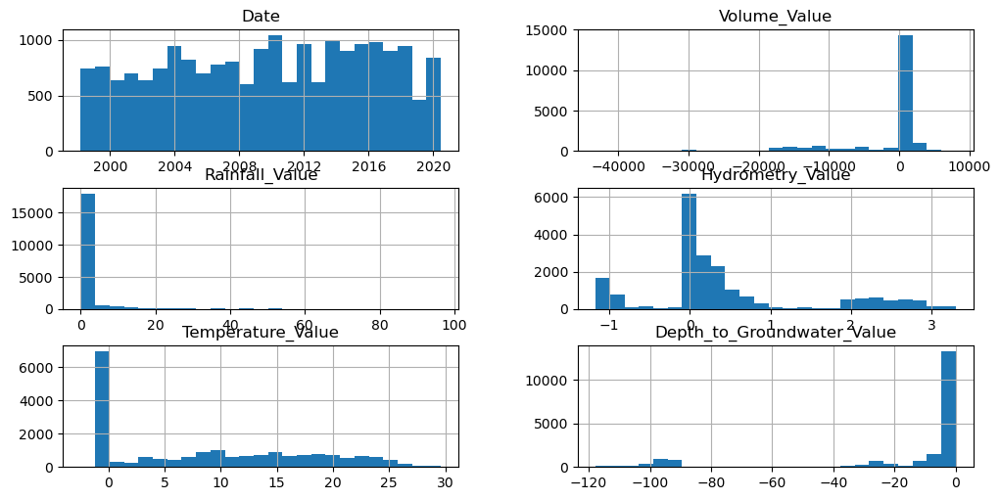

In [52]:
# Análisis Univariado de Water Spring Hydrology
df_aquifer_hydrology.hist(figsize=(12,10), layout=(5, 2), bins=25)
plt.show()

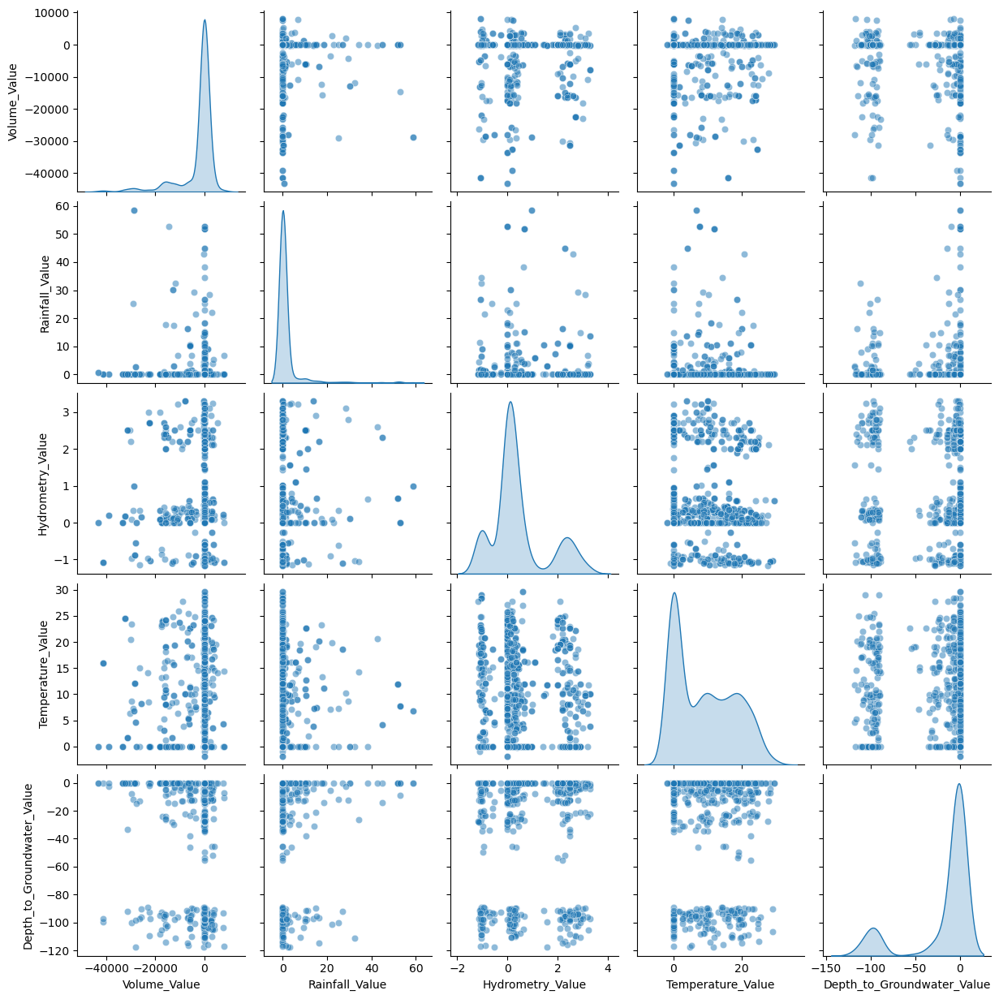

In [53]:
# Análisis Univariado de Water Spring Hydrology
df_sample_ws = df_aquifer_hydrology.sample(n=1000) # O .sample(frac=0.01) para el 1% de los datos
sns.pairplot(df_sample_ws, diag_kind='kde', markers='o', plot_kws={'alpha': 0.5})

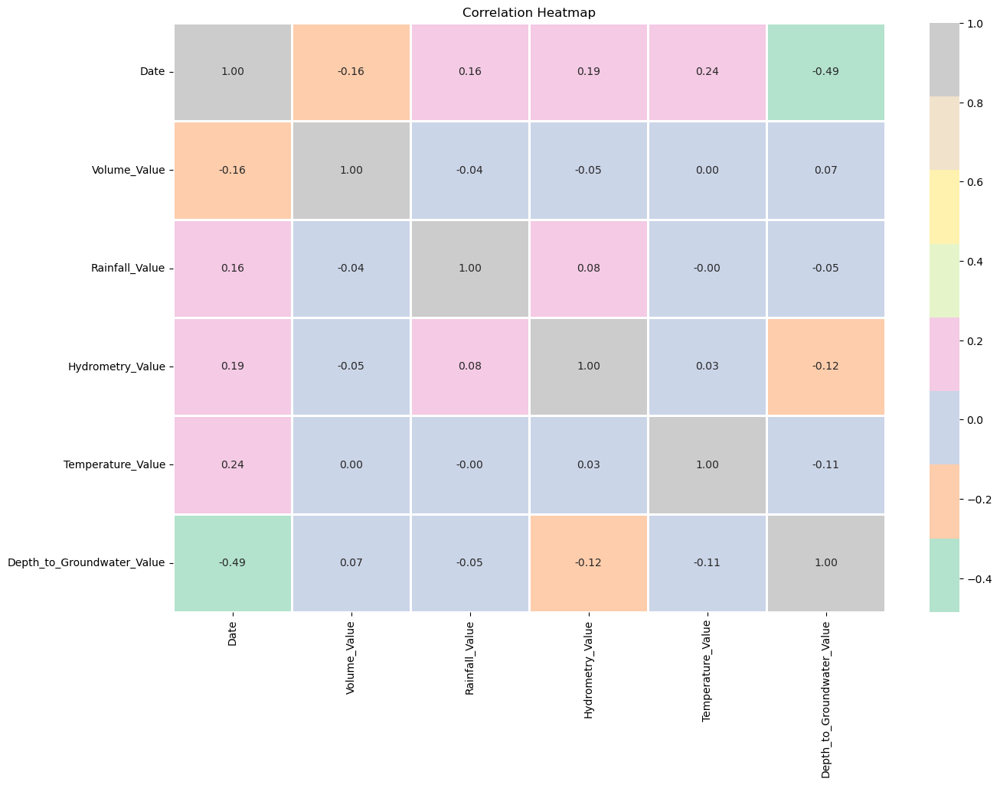

In [54]:
# Correlación entre variables
plt.figure(figsize=(15, 10))
sns.heatmap(df_aquifer_hydrology.corr(), annot=True, fmt='.2f', cmap='Pastel2', linewidths=2)

plt.title('Correlation Heatmap')
plt.show()

# 6. Guardar datos limpios. 

In [55]:
df_aquifer_hydrology.head()

,Date,Volume_Value,Rainfall_Value,Hydrometry_Value,Temperature_Value,Depth_to_Groundwater_Value
0,2018-01-20,-28050.624,2.6,-0.54,4.7,-12.77
1,2008-03-18,0.000,0.0,0.36,12.9,-14.48
2,1998-04-18,0.000,0.0,0.00,0.0,0.00
3,2017-04-28,3065.940,0.0,0.31,0.0,-12.21
4,2006-10-03,0.000,0.0,0.11,21.6,-15.12


In [56]:
# Guardar el DataFrame limpio y preprocesado
df_aquifer_hydrology.to_csv('../data/processed/aquifers/aquifers_hydrology_data_clean.csv', index=False)